In [1]:
import pandas as pd
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
import pprint
import warnings
warnings.filterwarnings('ignore')

pd.set_option("display.max_rows", None)   # show all rows
pd.set_option("display.max_columns", None)  # show all columns
pd.set_option("display.width", None)     # don't wrap columns
pd.set_option("display.max_colwidth", None)  # don't truncate long text


## Importing CSV files

In [ ]:
import pandas as pd
import os

# Adjust these paths
input_folder = r'C:\# Online Courses\NYP\MLandOpsProj\c17'
output_file = 'combined_c17.csv'

# Remove existing output if you want a clean start
if os.path.exists(output_file):
    os.remove(output_file)

# Process all CSVs
for filename in os.listdir(input_folder):
    if filename.endswith('.csv'):
        file_path = os.path.join(input_folder, filename)

        # Get file prefix like 'c17'
        cohort = filename.split('.')[0]  # or use regex if format is inconsistent
        user_id = filename.split('.')[1].strip('p')
        # combi_user_id = cohort.strip('c')+'0'+user_id

        print(f"Processing {filename}") # as {label}")

        # Read in chunks
        chunk_size = 100_000
        for chunk in pd.read_csv(file_path, chunksize=chunk_size):
            # Keep only rows where 'activity_label' is not empty
            filtered_chunk = chunk[chunk['activity_label'].notna()].copy()
            # filtered_chunk['group_label'] = label
            filtered_chunk['user_id'] = user_id #combi_user_id

            # Append to output
            filtered_chunk.to_csv(output_file, mode='a', header=not os.path.exists(output_file), index=False)

    print("Saved to:", os.path.abspath(output_file))


Saved to: c:\# Online Courses\NYP\MLandOpsProj\working\iti113_adls\combined_c17.csv
Processing c17.p001.csv
Saved to: c:\# Online Courses\NYP\MLandOpsProj\working\iti113_adls\combined_c17.csv
Processing c17.p002.csv
Saved to: c:\# Online Courses\NYP\MLandOpsProj\working\iti113_adls\combined_c17.csv
Processing c17.p003.csv
Saved to: c:\# Online Courses\NYP\MLandOpsProj\working\iti113_adls\combined_c17.csv
Processing c17.p004.csv
Saved to: c:\# Online Courses\NYP\MLandOpsProj\working\iti113_adls\combined_c17.csv
Processing c17.p005.csv
Saved to: c:\# Online Courses\NYP\MLandOpsProj\working\iti113_adls\combined_c17.csv
Processing c17.p006.csv
Saved to: c:\# Online Courses\NYP\MLandOpsProj\working\iti113_adls\combined_c17.csv
Processing c17.p007.csv
Saved to: c:\# Online Courses\NYP\MLandOpsProj\working\iti113_adls\combined_c17.csv
Processing c17.p008.csv
Saved to: c:\# Online Courses\NYP\MLandOpsProj\working\iti113_adls\combined_c17.csv
Processing c17.p009.csv
Saved to: c:\# Online Course

## Dryad (ArWISE) dataset
https://datadryad.org/landing/show?id=doi%3A10.5061%2Fdryad.jdfn2z3nm#readme

In [44]:
# Load the combined dataset
df = pd.read_csv("./combined_c17.csv")

### Brief overview of combined dataset

In [45]:
print(df.head())

               stamp_start                stamp_end  yaw_mean  pitch_mean  \
0  2023-01-28 10:57:21.821  2023-01-28 10:58:21.784 -0.690362   -0.608920   
1  2023-01-28 10:57:22.821  2023-01-28 10:58:22.783 -0.659091   -0.607907   
2  2023-01-28 10:57:23.820  2023-01-28 10:58:23.783 -0.616051   -0.607774   
3  2023-01-28 10:57:24.819  2023-01-28 10:58:24.782 -0.579319   -0.609040   
4  2023-01-28 10:57:25.819  2023-01-28 10:58:25.781 -0.542710   -0.610304   

   roll_mean  rotation_rate_x_mean  rotation_rate_y_mean  \
0  -0.608920              0.014896             -0.021061   
1  -0.607907              0.003650             -0.020898   
2  -0.607774              0.003679             -0.023021   
3  -0.609040              0.003764             -0.022758   
4  -0.610304              0.003763             -0.022828   

   rotation_rate_z_mean  user_acceleration_x_mean  user_acceleration_y_mean  \
0              0.018753                  0.000663                  0.000663   
1              0.0

In [46]:
# Summarising structure
print(df.info(), '\n\n')

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 408270 entries, 0 to 408269
Data columns (total 42 columns):
 #   Column                             Non-Null Count   Dtype  
---  ------                             --------------   -----  
 0   stamp_start                        408270 non-null  object 
 1   stamp_end                          408270 non-null  object 
 2   yaw_mean                           408270 non-null  float64
 3   pitch_mean                         408270 non-null  float64
 4   roll_mean                          408270 non-null  float64
 5   rotation_rate_x_mean               408270 non-null  float64
 6   rotation_rate_y_mean               408270 non-null  float64
 7   rotation_rate_z_mean               408270 non-null  float64
 8   user_acceleration_x_mean           408270 non-null  float64
 9   user_acceleration_y_mean           408270 non-null  float64
 10  user_acceleration_z_mean           408270 non-null  float64
 11  yaw_std                            4082

#### Investigate null in speed, course

In [47]:
print(df[df["speed_mean"].notna()].head())

                       stamp_start                   stamp_end  yaw_mean  \
206550  2023-08-27 10:41:05.049786  2023-08-27 10:42:04.960542 -0.427316   
206551  2023-08-27 10:41:06.053316  2023-08-27 10:42:05.964074 -0.374461   
206552  2023-08-27 10:41:07.056845  2023-08-27 10:42:06.967603 -0.324193   
206553  2023-08-27 10:41:08.060375  2023-08-27 10:42:07.971135 -0.271607   
206554  2023-08-27 10:41:09.063905  2023-08-27 10:42:08.974665 -0.217397   

        pitch_mean  roll_mean  rotation_rate_x_mean  rotation_rate_y_mean  \
206550   -0.683087  -2.039293             -0.042459              0.030807   
206551   -0.710222  -2.053805             -0.042017              0.031838   
206552   -0.736964  -2.068180             -0.042264              0.033391   
206553   -0.764395  -2.081934             -0.042404              0.032216   
206554   -0.791469  -2.096462             -0.041684              0.031045   

        rotation_rate_z_mean  user_acceleration_x_mean  \
206550              0.

In [48]:
print(df[df["speed_mean"].notna()]["speed_mean"].value_counts())

speed_mean
-1.000000     33794
 0.000000     17322
 0.695259      1080
 0.003221      1003
 0.949376       720
 0.564643       720
 1.533889       647
 3.428661       360
 3.789345       360
 1.108936       360
 0.262350       360
 0.686806       360
 0.902294       360
 0.442831       360
 0.276766       360
 0.851794       360
 0.516968       360
 1.150398       360
 0.116717       359
 0.082820       359
 0.105418       359
 0.472797       359
 0.130184       320
 0.824810       310
 0.996465       279
 0.221679       269
 0.055087       240
 0.844285       214
 0.165102       213
 0.507124       203
 0.733748       192
 0.830909       155
 1.940111       142
 0.515129        92
 0.023163        88
 0.001376        78
 1.533889        73
-0.680602        72
 0.507124        71
 0.431154        60
 0.001818        59
 0.005932        57
 0.001100        54
 0.001005        54
 0.000420        53
 0.002540        53
 0.007964        52
 0.000724        52
 0.024343        52
 0.001033

In [49]:
# value of -1 indicates GPS course unavailable -> change to NaN
df[["speed_mean", "speed_std", "course_mode", "course_std"]] = df[["speed_mean", "speed_std", "course_mode", "course_std"]].replace(-1, np.nan)

In [73]:
print(df.info(), '\n\n')

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 408270 entries, 0 to 408269
Data columns (total 42 columns):
 #   Column                             Non-Null Count   Dtype  
---  ------                             --------------   -----  
 0   stamp_start                        408270 non-null  object 
 1   stamp_end                          408270 non-null  object 
 2   yaw_mean                           408270 non-null  float64
 3   pitch_mean                         408270 non-null  float64
 4   roll_mean                          408270 non-null  float64
 5   rotation_rate_x_mean               408270 non-null  float64
 6   rotation_rate_y_mean               408270 non-null  float64
 7   rotation_rate_z_mean               408270 non-null  float64
 8   user_acceleration_x_mean           408270 non-null  float64
 9   user_acceleration_y_mean           408270 non-null  float64
 10  user_acceleration_z_mean           408270 non-null  float64
 11  yaw_std                            4082

In [418]:
# drop rows with empty speed, course
df2 = df[
    df["course_mode"].notna() &
    df["speed_mean"].notna() &
    df["speed_std"].notna() &
    df["course_std"].notna()
].copy().reset_index(drop=True)


## df2 
with dropped rows where speed, course were empty

### basic checks

In [419]:
print(df2.info(), '\n\n')

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 155208 entries, 0 to 155207
Data columns (total 42 columns):
 #   Column                             Non-Null Count   Dtype  
---  ------                             --------------   -----  
 0   stamp_start                        155208 non-null  object 
 1   stamp_end                          155208 non-null  object 
 2   yaw_mean                           155208 non-null  float64
 3   pitch_mean                         155208 non-null  float64
 4   roll_mean                          155208 non-null  float64
 5   rotation_rate_x_mean               155208 non-null  float64
 6   rotation_rate_y_mean               155208 non-null  float64
 7   rotation_rate_z_mean               155208 non-null  float64
 8   user_acceleration_x_mean           155208 non-null  float64
 9   user_acceleration_y_mean           155208 non-null  float64
 10  user_acceleration_z_mean           155208 non-null  float64
 11  yaw_std                            1552

### Timestamp feature engineering
- convert 'stamp_start' and 'stamp_end' into 'timeframe'
- get total duration of each activity for each user, each instance
- frequency of activity per user per day & per user per week

#### convert 'stamp_start' and 'stamp_end' into 'timeframe'

In [420]:
import pandas as pd

# Convert to datetime
df2["start_time"] = pd.to_datetime(df2["stamp_start"])
df2["end_time"] = pd.to_datetime(df2["stamp_end"])

# Row-wise timeframe (end - start)
df2["timeframe"] = df2["end_time"] - df2["start_time"]
df2["timeframe_seconds"] = df2["timeframe"].dt.total_seconds()



#### get total duration of each activity for each user, each instance

In [421]:
# Sort by user, activity, and start time
df2 = df2.sort_values(["user_id", "activity_label", "stamp_start"]).reset_index(drop=True)

# Define new instance when gap occurs between end time and new start time
df2["activity_instance"] = (
    (df2["stamp_start"] > df2.groupby(["user_id", "activity_label"])["end_time"].shift())
    .groupby([df2["user_id"], df2["activity_label"]])
    .cumsum()
)

# Compute duration per instance
total_time = (
    df2.groupby(["user_id", "activity_label", "activity_instance"])
      .agg(duration=("end_time", lambda x: x.max() - x.min()))
      .reset_index()
)
total_time["duration_minutes"] = total_time["duration"].dt.total_seconds() / 60 # convert to mins

df2 = df2.merge(total_time, on=["user_id", "activity_label", "activity_instance"], how="left")


#### frequency of activity per user per day & per user per week

In [422]:
df2["date"] = df2["start_time"].dt.date
df2["week"] = df2["start_time"].dt.to_period("W").apply(lambda r: r.start_time.date())

daily_freq = (
    df2.groupby(["user_id", "activity_label", "date"])["activity_instance"]
      .nunique() # count unique activity instances
      .reset_index(name="daily_freq")
)

weekly_freq = (
    df2.groupby(["user_id", "activity_label", "week"])["activity_instance"]
      .nunique()
      .reset_index(name="weekly_freq")
)

df2 = df2.merge(daily_freq, on=["user_id", "activity_label", "date"], how="left")
df2 = df2.merge(weekly_freq, on=["user_id", "activity_label", "week"], how="left")


In [423]:
print(df2.head())

                  stamp_start                   stamp_end  yaw_mean  \
0  2023-08-29 17:16:32.103325  2023-08-29 17:17:31.920510 -1.747497   
1  2023-08-29 17:16:33.106971  2023-08-29 17:17:32.924150 -1.743268   
2  2023-08-29 17:16:34.110616  2023-08-29 17:17:33.927791 -1.740303   
3  2023-08-29 17:16:35.114262  2023-08-29 17:17:34.931431 -1.737958   
4  2023-08-29 17:16:36.017543  2023-08-29 17:17:35.935072 -1.736050   

   pitch_mean  roll_mean  rotation_rate_x_mean  rotation_rate_y_mean  \
0   -0.786697  -0.671447              0.004176              0.001794   
1   -0.782796  -0.667468              0.003520              0.001534   
2   -0.779417  -0.664350              0.002626              0.001299   
3   -0.776306  -0.661640              0.002396              0.001253   
4   -0.773547  -0.659273              0.002237              0.001310   

   rotation_rate_z_mean  user_acceleration_x_mean  user_acceleration_y_mean  \
0              0.000121                  0.001119            

In [424]:
print(df2['activity_instance'].value_counts())

activity_instance
0     62137
1     37824
2     22361
3     12493
4      6417
6      3985
5      3558
7      2478
8      2159
9      1076
10      360
11      360
Name: count, dtype: int64


In [425]:
print(df2[["time_of_day_radians", "time_of_day_sin", "time_of_day_cos"]].head())


   time_of_day_radians  time_of_day_sin  time_of_day_cos
0             4.524766         -0.98245        -0.186524
1             4.524766         -0.98245        -0.186524
2             4.524766         -0.98245        -0.186524
3             4.524766         -0.98245        -0.186524
4             4.524766         -0.98245        -0.186524


In [426]:
# drop unused features

# stamp_start, stamp_end, start_time, end_time : used to get 'timeframe' and 'duration'
# date, week: used to get 'daily_freq' and 'weekly_freq'
# duration, timeframe: converted to minutes, seconds
df2 = df2.drop(columns=['stamp_start','stamp_end',
                        'start_time','end_time',
                        'date','week',
                        'duration','timeframe'])

In [427]:
print(df2.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 155208 entries, 0 to 155207
Data columns (total 45 columns):
 #   Column                             Non-Null Count   Dtype  
---  ------                             --------------   -----  
 0   yaw_mean                           155208 non-null  float64
 1   pitch_mean                         155208 non-null  float64
 2   roll_mean                          155208 non-null  float64
 3   rotation_rate_x_mean               155208 non-null  float64
 4   rotation_rate_y_mean               155208 non-null  float64
 5   rotation_rate_z_mean               155208 non-null  float64
 6   user_acceleration_x_mean           155208 non-null  float64
 7   user_acceleration_y_mean           155208 non-null  float64
 8   user_acceleration_z_mean           155208 non-null  float64
 9   yaw_std                            155208 non-null  float64
 10  pitch_std                          155208 non-null  float64
 11  roll_std                           1552

## Data cleaning

### Duplicates handling

In [428]:
# Check for duplicated rows
print('Duplicated rows: ')
print(df2.duplicated().sum())
duplicates = df2[df2.duplicated(keep=False)]
print(duplicates)

# Check for duplicated columns
print('Duplicated cols: ')
print(df2.columns[df2.columns.duplicated()].tolist())


# Check for duplicate rows excluding 'user_id'
duplicates_except_id = df2[df2.drop(columns='user_id').duplicated(keep=False)]
# Sort to view nicely
duplicates_except_id = duplicates_except_id.sort_values(by=list(df2.columns.difference(['user_id'])))
print('Duplicate rows (except user_id):')
print(duplicates_except_id)


Duplicated rows: 
0
Empty DataFrame
Columns: [yaw_mean, pitch_mean, roll_mean, rotation_rate_x_mean, rotation_rate_y_mean, rotation_rate_z_mean, user_acceleration_x_mean, user_acceleration_y_mean, user_acceleration_z_mean, yaw_std, pitch_std, roll_std, rotation_rate_x_std, rotation_rate_y_std, rotation_rate_z_std, user_acceleration_x_std, user_acceleration_y_std, user_acceleration_z_std, rotation_magnitude_mean, acceleration_magnitude_mean, rotation_magnitude_std, acceleration_magnitude_std, speed_mean, speed_std, course_mode, course_std, distance_from_home_mean, distance_from_home_std, distance_from_home_latitude_mean, distance_from_home_latitude_std, distance_from_home_longitude_mean, distance_from_home_longitude_std, bearing_from_home_mode, bearing_from_home_std, time_of_day_radians, time_of_day_sin, time_of_day_cos, day_of_week, activity_label, user_id, timeframe_seconds, activity_instance, duration_minutes, daily_freq, weekly_freq]
Index: []
Duplicated cols: 
[]
Duplicate rows (ex

Conclusion: many rows that are duplicated across user_id -> to drop duplicates based on all columns except user_id, keeping first row.

In [429]:
# Drop duplicates based on all columns except 'user_id', keep the first row
df2 = df2.drop_duplicates(subset=df2.columns.difference(['user_id']), keep='first')


### Standardize activities

In [430]:
print(df2['activity_label'].value_counts())

activity_label
chores           23691
relax            21682
job              21481
eat              13879
hobby            13814
entertainment    11688
exercise         11537
errands           9147
sleep             7135
travel            6497
hygiene           5222
school             360
Name: count, dtype: int64


The activities in this dataset are already standardized into a few categories, no need to standardize.

In [431]:
# Convert to lowercase for easier matching
df2['activity_label'] = df2['activity_label'].astype(str).str.lower()

# 4. Activity categorization by health relevance
health_categories = {
    'Essential ADLs': ['chores', 'eat', 'hygiene'],
    'Health Indicators': ['exercise', 'sleep'],  
    'Independence/Social': ['errands', 'travel'],
    'Leisure/Behavioral': ['relax', 'entertainment', 'hobby'],
    'Cognitive': ['job','school']
}

# Invert the mapping: activity -> category
activity_to_category = {activity: category 
                        for category, activities in health_categories.items() 
                        for activity in activities}

# Map to a new column
df2["activity_category"] = df2["activity_label"].map(activity_to_category)

# Categorizing into ADLs
adl_mapping = {
    "ADL": ["eat", "hygiene", "chores", "exercise", "sleep"],
    "IADL": ["errands", "travel", "relax", "entertainment", "hobby", "job", "school"]
}

# Map to new column
df2["ADL_category"] = df2["activity_label"].map(
    {a: k for k, v in adl_mapping.items() for a in v}
)

In [432]:
activities_to_drop = ["job", "school", "travel"]  # example list
df2 = df2[~df2["activity_label"].isin(activities_to_drop)].reset_index(drop=True)

In [433]:
print(df2['activity_category'].unique())
print(df2['ADL_category'].unique())

['Essential ADLs' 'Leisure/Behavioral' 'Health Indicators'
 'Independence/Social']
['ADL' 'IADL']


#### Missing values

In [434]:
# Detecting missing values
missing_list = list(df2.columns[df2.isna().any()])       

# Percentage of missing values
row_count = df2.shape[0] 
# Create list of dicts (one per column)
data = []
for col in missing_list:
    count = df2[col].isnull().sum()
    percent = (count / row_count) * 100
    data.append({
        'Columns with missing values': col,
        'Missing count': count,
        'Missing %': percent,
        'DataType' : df2[col].dtype
    })

# Create DataFrame from list of dicts
missing_df = pd.DataFrame(data)
print(missing_df)

Empty DataFrame
Columns: []
Index: []


No missing values (all dropped earlier).
Missing values were dropped instead of imputed, because:
- it is difficult to impute information like the speed and course of the person's travel GPS readings as anyone can go anywhere at any speed
- there are a lot of other complete data rows

## Feature engineering

### Cyclic day-of-week features

In [435]:
df2["day_of_week_sin"] = np.sin(2*np.pi*df2["day_of_week"]/7)
df2["day_of_week_cos"] = np.cos(2*np.pi*df2["day_of_week"]/7)

### Normalized activity duration

#### Duration normalized per user
(activity duration - avg duration of all activities for user) / user's standard dev of duration for all activities

compares each activity instance against that user’s typical duration across all activities.

* Captures relative behavior per user

    * Some users are generally slow, others fast. Comparing durations across users is tricky without standardization.

    * This z-score tells you whether a given activity instance is long or short for that user, even if they do different types of activities.

* Highlights outliers in overall behavior

    * Example: a normally fast walker takes a very long time to walk → high z-score.

    * Example: a generally slow user takes a very short time to eat → negative z-score.

In [436]:
# calculate duration per activity instance 
df_instance = (
    df2.groupby(['user_id', 'activity_label', 'activity_instance'])
       .agg(duration_minutes=('duration_minutes', 'first'))  # or recalc if needed
       .reset_index()
)


In [437]:
# Compute mean and std per user
user_stats = (
    df_instance.groupby('user_id')['duration_minutes']
               .agg(user_mean='mean', user_std='std')
               .reset_index()
)

# Merge back
df_instance = df_instance.merge(user_stats, on='user_id', how='left')

# Compute z-score
df_instance['duration_zscore_user_all_acts'] = (
    (df_instance['duration_minutes'] - df_instance['user_mean']) / df_instance['user_std']
)


#### Duration normalized per user, per activity

(activity duration - avg activity duration) / user's standard dev of duration for that activity

-> compares each instance against that user's pattern for that specific activity

* Personalized normalization per activity

    * Users have different habits. One user may always walk slowly, another quickly.

    * Standardizing per activity per user lets you detect “unusually long or short instances” relative to that user’s own history, not everyone’s average.

* Removes activity-specific scale differences

    * Some activities are naturally longer (e.g., sleep) than others (eat).


In [438]:
# Compute mean and std per user & activity
user_act_stats = (
    df_instance.groupby(['user_id', 'activity_label'])['duration_minutes']
               .agg(user_act_mean='mean', user_act_std='std')
               .reset_index()
)

# Merge back
df_instance = df_instance.merge(user_act_stats, on=['user_id', 'activity_label'], how='left')

# Compute z-score
df_instance['duration_zscore_user_each_act'] = (
    (df_instance['duration_minutes'] - df_instance['user_act_mean']) / df_instance['user_act_std']
)


In [439]:
# z-score = 0 means this activity is the user's typical duration
df_instance['duration_zscore_user_each_act'].fillna(0, inplace=True)


In [440]:
print(df_instance.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 362 entries, 0 to 361
Data columns (total 10 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   user_id                        362 non-null    int64  
 1   activity_label                 362 non-null    object 
 2   activity_instance              362 non-null    int64  
 3   duration_minutes               362 non-null    float64
 4   user_mean                      362 non-null    float64
 5   user_std                       362 non-null    float64
 6   duration_zscore_user_all_acts  362 non-null    float64
 7   user_act_mean                  362 non-null    float64
 8   user_act_std                   302 non-null    float64
 9   duration_zscore_user_each_act  362 non-null    float64
dtypes: float64(7), int64(2), object(1)
memory usage: 28.4+ KB
None


#### Merge back to main df

In [441]:
# Merge z-scores back to df2
df2 = df2.merge(
    df_instance[['user_id', 'activity_label', 'activity_instance',
                 'duration_zscore_user_all_acts', 'duration_zscore_user_each_act']],
    on=['user_id', 'activity_label', 'activity_instance'],
    how='left'
)


In [442]:
print(df2.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 117795 entries, 0 to 117794
Data columns (total 51 columns):
 #   Column                             Non-Null Count   Dtype  
---  ------                             --------------   -----  
 0   yaw_mean                           117795 non-null  float64
 1   pitch_mean                         117795 non-null  float64
 2   roll_mean                          117795 non-null  float64
 3   rotation_rate_x_mean               117795 non-null  float64
 4   rotation_rate_y_mean               117795 non-null  float64
 5   rotation_rate_z_mean               117795 non-null  float64
 6   user_acceleration_x_mean           117795 non-null  float64
 7   user_acceleration_y_mean           117795 non-null  float64
 8   user_acceleration_z_mean           117795 non-null  float64
 9   yaw_std                            117795 non-null  float64
 10  pitch_std                          117795 non-null  float64
 11  roll_std                           1177

### Combinations of motion

#### Total orientation

In [443]:
df2["total_orientation_variability"] = df2["yaw_std"] + df2["pitch_std"] + df2["roll_std"]

df2["total_orientation"] = df2["yaw_mean"] + df2["pitch_mean"] + df2["roll_mean"]

#### Total motion

In [444]:
df2["total_motion"] = df2["rotation_magnitude_mean"] + df2["acceleration_magnitude_mean"]

df2["total_motion_variabliity"] = df2["rotation_magnitude_std"] + df2["acceleration_magnitude_std"]

#### Speed * orientation stability

In [445]:
# high speed, low rotation -> in transport
# moderate speed, high rotation -> running, walking
# low speed, any rotation -> sitting

df2["speed_n_orientation_stability"] = df2["speed_mean"] / (df2["rotation_magnitude_std"] + 1e-6) # 1e-6 to avoid division by 0

### Combination of time-related features

#### Duration * frequency

In [446]:
df2["duration_n_daily_freq"] = df2["duration_minutes"] * df2["daily_freq"]
df2["duration_n_weekly_freq"] = df2["duration_minutes"] * df2["weekly_freq"]

### Distance from home

#### Binning distance from home mean

In [447]:
import pandas as pd

# fixed bins (e.g. in meters)
bins = [0, 50, 500, 2000, 5000, float('inf')]
labels = ['At home (0-50m)', 'Within walking-distance (50-500m)', '30-mins-walk (500-2km)', 'Far (2km-5km)', 'Very far (>5km)']

df2['distance_from_home_mean_bin_fixed'] = pd.cut(
    df2['distance_from_home_mean'],
    bins=bins,
    labels=labels,
    include_lowest=True
)

df2 = df2.drop(columns='distance_from_home_mean')

### Overview after feature engineering

In [448]:
print(df2.head())

   yaw_mean  pitch_mean  roll_mean  rotation_rate_x_mean  \
0 -1.747497   -0.786697  -0.671447              0.004176   
1 -1.743268   -0.782796  -0.667468              0.003520   
2 -1.740303   -0.779417  -0.664350              0.002626   
3 -1.737958   -0.776306  -0.661640              0.002396   
4 -1.736050   -0.773547  -0.659273              0.002237   

   rotation_rate_y_mean  rotation_rate_z_mean  user_acceleration_x_mean  \
0              0.001794              0.000121                  0.001119   
1              0.001534             -0.000035                  0.001103   
2              0.001299              0.000018                  0.001167   
3              0.001253              0.000128                  0.001151   
4              0.001310              0.000228                  0.001167   

   user_acceleration_y_mean  user_acceleration_z_mean   yaw_std  pitch_std  \
0                  0.001119                  0.002495  0.047021   0.055464   
1                  0.001103     

In [449]:
print(df2.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 117795 entries, 0 to 117794
Data columns (total 58 columns):
 #   Column                             Non-Null Count   Dtype   
---  ------                             --------------   -----   
 0   yaw_mean                           117795 non-null  float64 
 1   pitch_mean                         117795 non-null  float64 
 2   roll_mean                          117795 non-null  float64 
 3   rotation_rate_x_mean               117795 non-null  float64 
 4   rotation_rate_y_mean               117795 non-null  float64 
 5   rotation_rate_z_mean               117795 non-null  float64 
 6   user_acceleration_x_mean           117795 non-null  float64 
 7   user_acceleration_y_mean           117795 non-null  float64 
 8   user_acceleration_z_mean           117795 non-null  float64 
 9   yaw_std                            117795 non-null  float64 
 10  pitch_std                          117795 non-null  float64 
 11  roll_std                  

## Data Analysis

### Review dataset after cleaning

In [450]:
print(df2.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 117795 entries, 0 to 117794
Data columns (total 58 columns):
 #   Column                             Non-Null Count   Dtype   
---  ------                             --------------   -----   
 0   yaw_mean                           117795 non-null  float64 
 1   pitch_mean                         117795 non-null  float64 
 2   roll_mean                          117795 non-null  float64 
 3   rotation_rate_x_mean               117795 non-null  float64 
 4   rotation_rate_y_mean               117795 non-null  float64 
 5   rotation_rate_z_mean               117795 non-null  float64 
 6   user_acceleration_x_mean           117795 non-null  float64 
 7   user_acceleration_y_mean           117795 non-null  float64 
 8   user_acceleration_z_mean           117795 non-null  float64 
 9   yaw_std                            117795 non-null  float64 
 10  pitch_std                          117795 non-null  float64 
 11  roll_std                  

### Descriptive statistics for each activity

In [451]:
# Distribution of each numeric feature by activity_label 

for label, group in df2.groupby("activity_label"):
    print(f"\n=== Stats for activity: {label} ===")
    print(group.describe(include='number').T)


=== Stats for activity: chores ===
                                     count        mean         std        min  \
yaw_mean                           23691.0   -0.002817    1.232227  -3.051652   
pitch_mean                         23691.0   -0.600108    0.383151  -1.464805   
roll_mean                          23691.0   -0.097303    1.163982  -3.114493   
rotation_rate_x_mean               23691.0    0.000593    0.036835  -0.230626   
rotation_rate_y_mean               23691.0    0.002361    0.037635  -0.233870   
rotation_rate_z_mean               23691.0   -0.005731    0.033502  -0.272016   
user_acceleration_x_mean           23691.0    0.013381    0.017572  -0.029199   
user_acceleration_y_mean           23691.0    0.013381    0.017572  -0.029199   
user_acceleration_z_mean           23691.0    0.009355    0.011708  -0.044227   
yaw_std                            23691.0    1.118500    0.741719   0.002149   
pitch_std                          23691.0    0.306387    0.192171   0.00

### Data Visualization

#### Categorical data visualization
For this dataset, these categorical features do not affect each other as each participant did all the activities for this dataset.
* The other categorical features are independent of activity_label. i.e. health_status and age_group counts would be same across all activities.
* The same proportion of activities are done by each person.
* Any of these categories can be used as the prediction label, with the other 2 categorical features dropped.

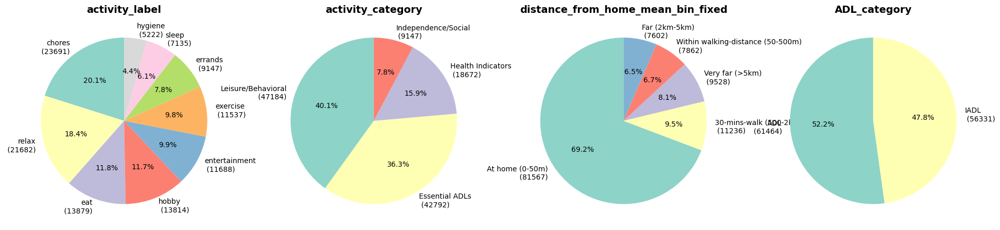

In [452]:
fig, axes = plt.subplots(1, 4, figsize=(24, 10))

for i,col in enumerate(['activity_label', 'activity_category','distance_from_home_mean_bin_fixed','ADL_category']):
    # Calculate health_status distribution
    counts = df2[col].value_counts()
    percentages = df2[col].value_counts(normalize=True) * 100
    # Create labels with counts
    labels_with_counts = [f"{label}\n ({count})" for label, count in zip(counts.index, counts.values)]

    # Pie chart
    colors = plt.cm.Set3(range(len(counts)))
    wedges, texts, autotexts = axes[i].pie(
        counts.values, 
        labels=labels_with_counts, 
        autopct='%1.1f%%', startangle=90, colors=colors)
    axes[i].set_title(col, fontsize=14, fontweight='bold')

plt.show()

#### Numeric data visualization by activity

['yaw_mean', 'pitch_mean', 'roll_mean', 'rotation_rate_x_mean', 'rotation_rate_y_mean', 'rotation_rate_z_mean', 'user_acceleration_x_mean', 'user_acceleration_y_mean', 'user_acceleration_z_mean', 'rotation_magnitude_mean', 'acceleration_magnitude_mean', 'speed_mean', 'distance_from_home_latitude_mean', 'distance_from_home_longitude_mean']


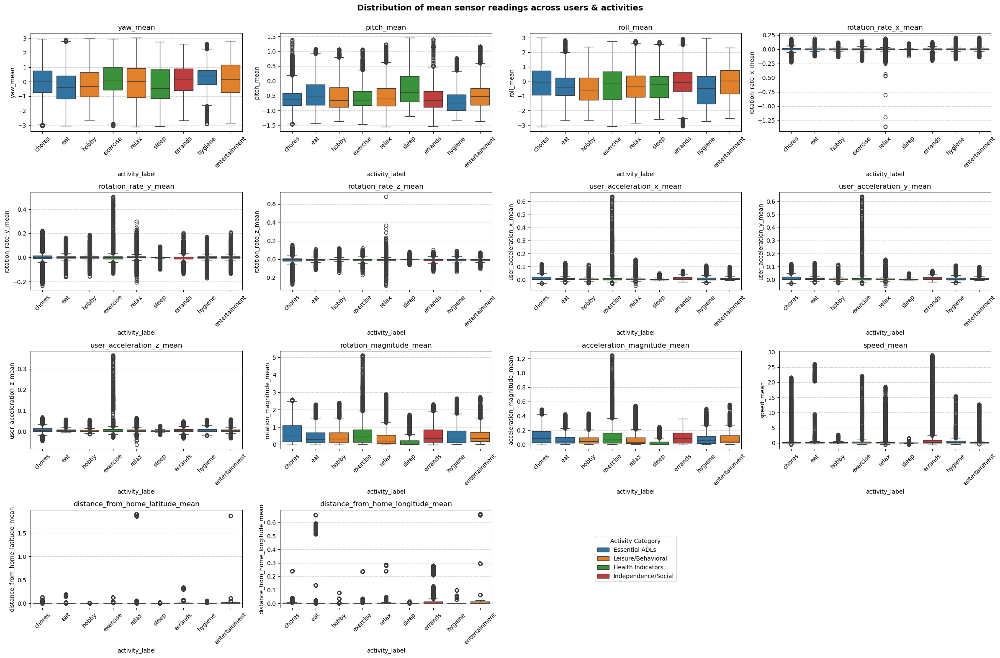

In [453]:
import seaborn as sns
import matplotlib.pyplot as plt
import math

# Take only mean features for visualization
mean_features = [col for col in df2.select_dtypes('number').columns if 'mean' in col]
print(mean_features)

n_features = len(mean_features)
n_cols = 4 # number of columns 
n_rows = math.ceil(n_features / n_cols)  # compute required rows

fig, axes = plt.subplots(n_rows, n_cols, figsize=(6*n_cols, 4*n_rows))
axes = axes.flatten()  # flatten in case of multiple rows for easy indexing

for i, feature in enumerate(mean_features):
    sns.boxplot(x='activity_label', y=feature, hue='activity_category', data=df2, ax=axes[i])
    axes[i].set_title(feature)
    axes[i].grid(axis='y', linestyle='--', alpha=0.6)
    axes[i].tick_params(axis='x', rotation=45)
    # remove individual legends
    axes[i].get_legend().remove()

# Turn off any unused axes and put legend there
for j in range(i+1, len(axes)):
    axes[j].axis('off')
    if j == i+1:  # use the *first* unused subplot for legend
        handles, labels = axes[0].get_legend_handles_labels()
        axes[j].legend(handles, labels, loc="center", title="Activity Category")

plt.tight_layout()
fig.suptitle('Distribution of mean sensor readings across users & activities', fontsize=14, fontweight='bold')
plt.tight_layout(rect=[0, 0, 1, 0.98])  # leave space for suptitle
plt.show()



**Interpreting mean:**

Mean of sensor readings is the average of all the time-based sensor readings for each user and each activity,
so these box plots are intended to show the possible spread/distribution of average sensor readings across users.

Distribution across users:
* Higher median across users, in mean sensor reading - users have higher average sensor readings
* Greater spread across users, in mean sensor reading - users differ in their average sensor readings

**Observations on median/spread of mean sensor readings, across users and activities:**

Main observations:
* More outliers and greater spread in mean user_acceleration (linear acceleration), acceleration magnitude and rotation rate magnitude for exercise. It is not clear what forms of exercise were included, and the variation in exercise could have accounted for the spread.
* more outliers for relax, for rotation rate
* no obvious difference between activities and activity categories for yaw, pitch, roll

['yaw_std', 'pitch_std', 'roll_std', 'rotation_rate_x_std', 'rotation_rate_y_std', 'rotation_rate_z_std', 'user_acceleration_x_std', 'user_acceleration_y_std', 'user_acceleration_z_std', 'rotation_magnitude_std', 'acceleration_magnitude_std', 'speed_std', 'course_std', 'distance_from_home_std', 'distance_from_home_latitude_std', 'distance_from_home_longitude_std', 'bearing_from_home_std']


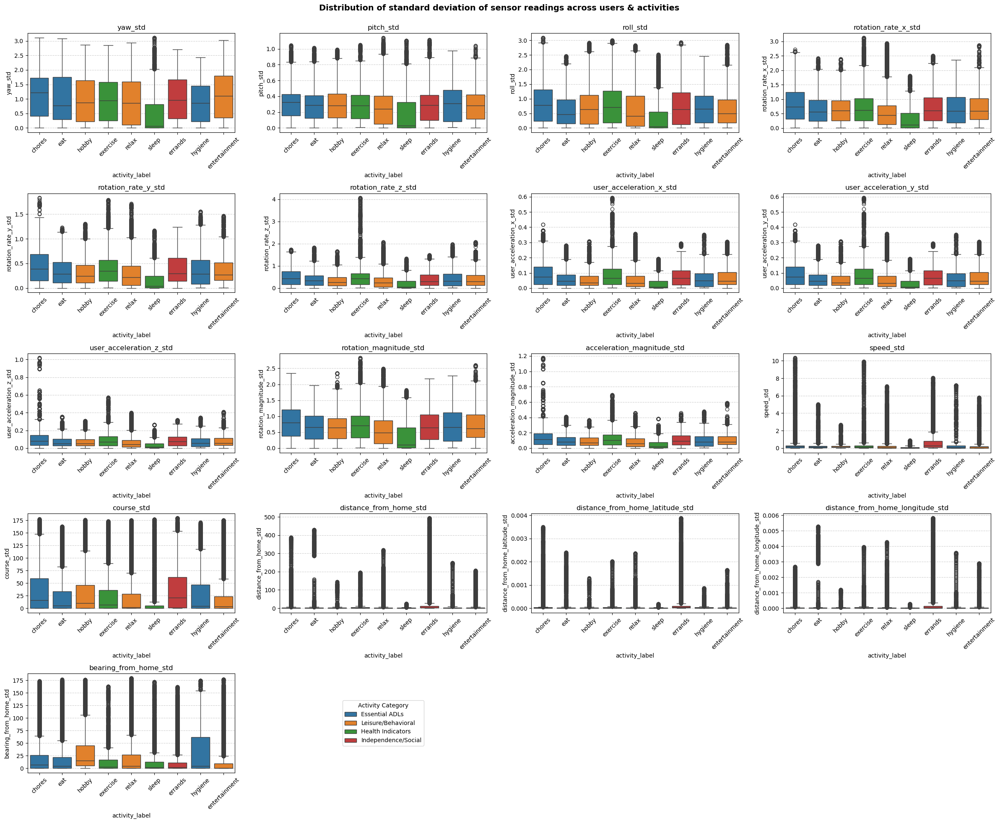

In [454]:
# Take only std features for visualization
std_features = [col for col in df2.select_dtypes('number').columns if 'std' in col]
print(std_features)

n_features = len(std_features)
n_cols = 4 # number of columns 
n_rows = math.ceil(n_features / n_cols)  # compute required rows

fig, axes = plt.subplots(n_rows, n_cols, figsize=(6*n_cols, 4*n_rows))
axes = axes.flatten()  # flatten in case of multiple rows for easy indexing

for i, feature in enumerate(std_features):
    sns.boxplot(x='activity_label', y=feature, hue='activity_category', data=df2, ax=axes[i])
    axes[i].set_title(feature)
    axes[i].grid(axis='y', linestyle='--', alpha=0.6)
    axes[i].tick_params(axis='x', rotation=45)

    # remove individual legends
    axes[i].get_legend().remove()

# Turn off any unused axes and put legend there
for j in range(i+1, len(axes)):
    axes[j].axis('off')
    if j == i+1:  # use the *first* unused subplot for legend
        handles, labels = axes[0].get_legend_handles_labels()
        axes[j].legend(handles, labels, loc="center", title="Activity Category")

plt.tight_layout()
fig.suptitle('Distribution of standard deviation of sensor readings across users & activities', fontsize=14, fontweight='bold')
plt.tight_layout(rect=[0, 0, 1, 0.98])  # leave space for suptitle
plt.show()

**Interpreting standard deviation:**
Standard deviation of sensor readings is a measure of the variability of the time-based sensor readings,
so these box plots are intended to show the possible spread/distribution of standard deviation in sensor readings across users.

Distribution across users:
* Higher median in standard deviation - across users, higher typical variability
* Greater spread in standard deviation - some users have more variable sensor readings than others
* Outliers - exceptionally unstable or stable sensor readings

**Observations on median/spread of standard deviation of sensor readings, across users and activities:**
Main observations:
* sleep has lower median of standard deviation readings across users and all metrics
* Some of the GPS-related features (course, bearing from home) have a wide spread and outliers in standard deviation across users for ‘sleep’. This suggests the inaccuracy in the GPS readings, as the readings vary more and are more unstable.

['course_mode', 'bearing_from_home_mode', 'time_of_day_radians', 'time_of_day_sin', 'time_of_day_cos', 'day_of_week', 'user_id', 'timeframe_seconds', 'activity_instance', 'duration_minutes', 'daily_freq', 'weekly_freq', 'day_of_week_sin', 'day_of_week_cos', 'duration_zscore_user_all_acts', 'duration_zscore_user_each_act', 'total_orientation_variability', 'total_orientation', 'total_motion', 'total_motion_variabliity', 'speed_n_orientation_stability', 'duration_n_daily_freq', 'duration_n_weekly_freq']


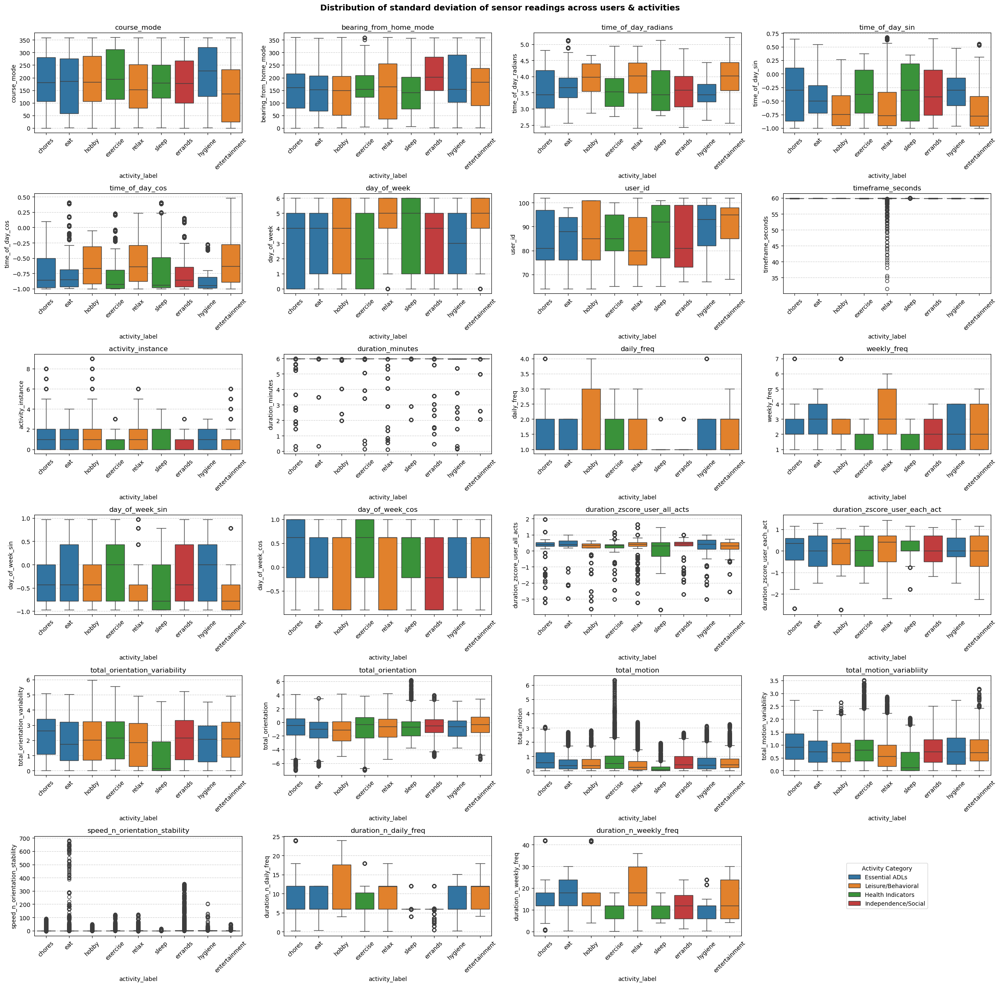

In [455]:
import seaborn as sns
import matplotlib.pyplot as plt
import math

# Take only mean features for visualization
sensor_features = [col for col in df2.select_dtypes('number').columns if not any(k in col for k in ['mean','std'])]
print(sensor_features)

n_features = len(sensor_features)
n_cols = 4 # number of columns 
n_rows = math.ceil(n_features / n_cols)  # compute required rows

fig, axes = plt.subplots(n_rows, n_cols, figsize=(6*n_cols, 4*n_rows))
axes = axes.flatten()  # flatten in case of multiple rows for easy indexing

for i, feature in enumerate(sensor_features):
    sns.boxplot(x='activity_label', y=feature, hue='activity_category', data=df2, ax=axes[i])
    axes[i].set_title(feature)
    axes[i].grid(axis='y', linestyle='--', alpha=0.6)
    axes[i].tick_params(axis='x', rotation=45)
    # remove individual legends
    axes[i].get_legend().remove()

# Turn off any unused axes and put legend there
for j in range(i+1, len(axes)):
    axes[j].axis('off')
    if j == i+1:  # use the *first* unused subplot for legend
        handles, labels = axes[0].get_legend_handles_labels()
        axes[j].legend(handles, labels, loc="center", title="Activity Category")

plt.tight_layout()
fig.suptitle('Distribution of standard deviation of sensor readings across users & activities', fontsize=14, fontweight='bold')
plt.tight_layout(rect=[0, 0, 1, 0.98])  # leave space for suptitle
plt.show()



**Observations on median/spread of other sensor readings, across users and activities:**

Main observations:
* timeframe in seconds seem fairly constant at 60s (which matches the 1-min window of data sampling). the outliers could be computation error. can drop this feature.


In [456]:
df2 = df2.drop(columns='timeframe_seconds')

## How numeric features affect target

In [457]:
from sklearn.feature_selection import SelectKBest, f_classif
from sklearn.preprocessing import LabelEncoder

# Copy all numerical columns from df into separate df
df_num = df2.select_dtypes(include='number').copy()

# Encode categorical target
le = LabelEncoder()
y_encoded = le.fit_transform(df2['activity_label'])

# Drop rows with any NaN values in the features or target (SelectKBest cannot take NaN, but cannot impute now)
temp_df = pd.concat([df_num, df2['activity_label']], axis=1).dropna()
X_clean = temp_df[df_num.columns]
y_clean = temp_df[df2['activity_label'].name]

# SelectKBest with ANOVA F-test
selector = SelectKBest(score_func=f_classif, k='all')
X_selected = selector.fit_transform(X_clean, y_clean)

# Pair feature names with their scores
feature_scores = pd.DataFrame({
    'Feature': df_num.columns,
    'F-statistic Score': selector.scores_,
    'P-value score': selector.pvalues_
}).sort_values(by='F-statistic Score', ascending=False)

print(feature_scores)

                              Feature  F-statistic Score  P-value score
51              duration_n_daily_freq        1819.301089   0.000000e+00
52             duration_n_weekly_freq        1728.528192   0.000000e+00
40                         daily_freq        1678.348904   0.000000e+00
41                        weekly_freq        1665.181651   0.000000e+00
22                         speed_mean        1325.998908   0.000000e+00
26             distance_from_home_std        1245.974030   0.000000e+00
34                    time_of_day_sin        1215.835050   0.000000e+00
30   distance_from_home_longitude_std        1134.649538   0.000000e+00
33                time_of_day_radians        1133.142014   0.000000e+00
28    distance_from_home_latitude_std        1047.335418   0.000000e+00
15            user_acceleration_x_std        1002.001828   0.000000e+00
16            user_acceleration_y_std        1002.001828   0.000000e+00
36                        day_of_week         994.046161   0.000

* Higher F-score shows that the feature discriminates between the activity categories better.
* Features with very low F-score or high p-value are weak predictors.

* this doesn't make sense! why is user_id highly predictive?

## Correlation check

### Numeric

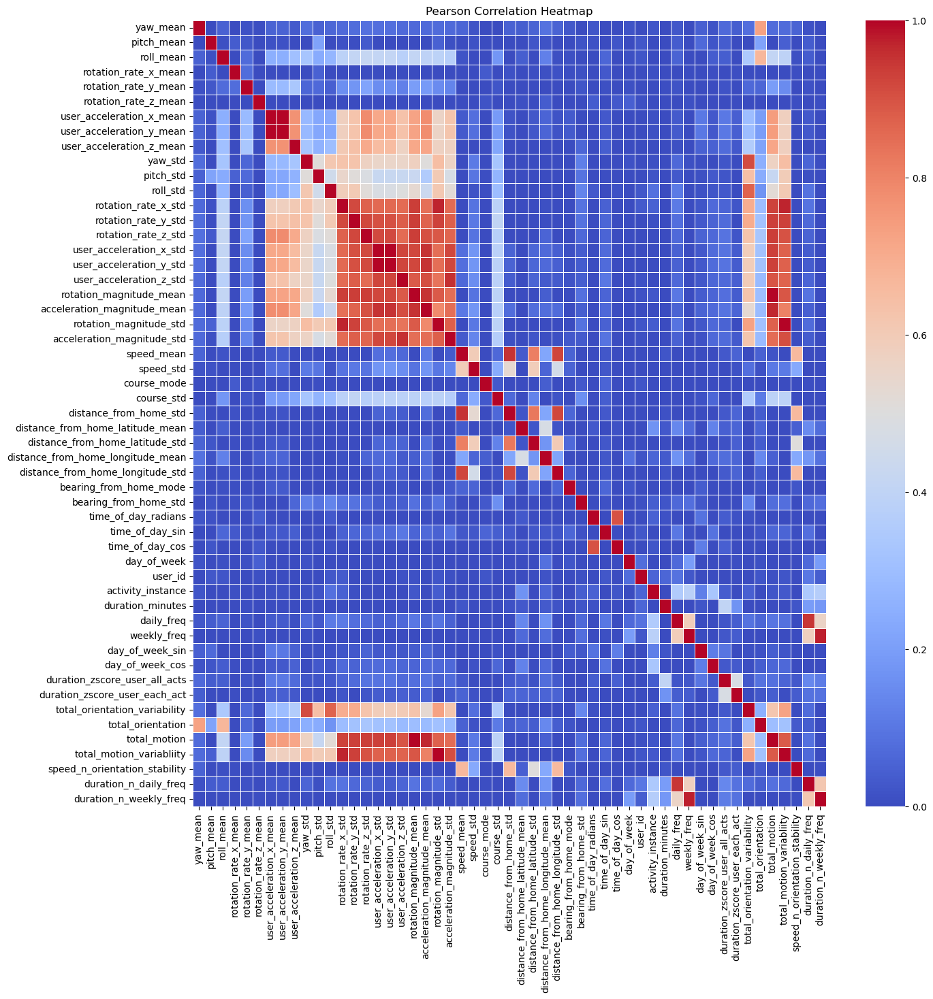

user_acceleration_x_mean - user_acceleration_y_mean: 1.00
user_acceleration_x_std - user_acceleration_y_std: 1.00
rotation_magnitude_mean - total_motion: 1.00
rotation_magnitude_std - total_motion_variabliity: 1.00
weekly_freq - duration_n_weekly_freq: 0.97
rotation_rate_x_std - rotation_magnitude_std: 0.97
time_of_day_radians - time_of_day_sin: -0.97
rotation_rate_x_std - total_motion_variabliity: 0.97
acceleration_magnitude_mean - total_motion: 0.97
user_acceleration_z_std - acceleration_magnitude_std: 0.95
speed_mean - distance_from_home_std: 0.95
rotation_magnitude_mean - acceleration_magnitude_mean: 0.95
user_acceleration_x_std - acceleration_magnitude_mean: 0.95
user_acceleration_y_std - acceleration_magnitude_mean: 0.95
daily_freq - duration_n_daily_freq: 0.95
rotation_rate_y_std - rotation_magnitude_mean: 0.94
rotation_rate_x_std - rotation_magnitude_mean: 0.94
rotation_rate_z_std - total_motion: 0.94
rotation_rate_z_std - rotation_magnitude_mean: 0.93
rotation_rate_y_std - tot

In [458]:
df_num = df2.select_dtypes(include='number').copy()
# Calculate the Pearson Correlation Matrix
corr_matrix_pear = df_num.corr(method='pearson')

# Plot the heatmap of the correlation matrix for the entire dataset
plt.figure(figsize=(15,15))
sns.heatmap(corr_matrix_pear, annot=False, cmap='coolwarm', vmin=0, center=0.5, vmax=1, linewidths=0.5, fmt='.2f')
plt.title('Pearson Correlation Heatmap')
plt.show()

# Collect high-correlation pairs
high_corr_pairs = []
mid_corr_pairs = []

for i in range(len(corr_matrix_pear.columns)):
    for j in range(i+1, len(corr_matrix_pear.columns)):
        col1 = corr_matrix_pear.columns[i]
        col2 = corr_matrix_pear.columns[j]
        corr_value = corr_matrix_pear.iloc[i, j]
        if abs(corr_value) >= 0.8:
            high_corr_pairs.append((col1, col2, corr_value))
        elif 0.6 < abs(corr_value) < 0.8:
            mid_corr_pairs.append((col1, col2, corr_value))

# Sort by absolute correlation in descending order
high_corr_pairs.sort(key=lambda x: abs(x[2]), reverse=True)

# Print
for col1, col2, corr_value in high_corr_pairs:
    print(f"{col1} - {col2}: {corr_value:.2f}")

print(f"\n{len(mid_corr_pairs)} pairs with moderate linear correlation (0.6 to 0.8)")

For each correlated feature pair with .corr() > 0.8, we will keep the feature with the higher F-score.


In [459]:
features_to_drop = [
    "user_acceleration_y_mean",
    "user_acceleration_y_std",
    "total_motion",
    "total_motion_variabliity",
    "weekly_freq",
    "rotation_magnitude_std",
    "time_of_day_radians",
    "rotation_rate_x_std",
    "acceleration_magnitude_mean",
    "user_acceleration_z_std",
    "distance_from_home_std",
    "rotation_magnitude_mean",
    "user_acceleration_x_std",
    "user_acceleration_y_std",
    "daily_freq",
    "rotation_rate_y_std",
    "rotation_rate_x_std",
    "rotation_rate_z_std",
    "rotation_rate_y_std",
    "rotation_rate_y_std",
    "user_acceleration_x_std",
    "user_acceleration_y_std",
    "rotation_rate_x_std",
    "rotation_rate_y_std",
    "user_acceleration_x_std",
    "user_acceleration_y_std",
    "rotation_rate_z_std",
    "rotation_rate_z_std",
    "rotation_rate_x_std",
    "yaw_std",
    "acceleration_magnitude_std",
    "user_acceleration_z_std",
    "rotation_rate_y_std",
    "rotation_rate_y_std",
    "rotation_rate_z_std",
    "rotation_rate_z_std",
    "time_of_day_radians",
    "user_acceleration_z_std",
    "total_motion_variabliity",
    "rotation_magnitude_std",
    "rotation_rate_y_std",
    "rotation_magnitude_std",
    "rotation_rate_y_std",
    "rotation_magnitude_std",
    "rotation_rate_x_std",
    "user_acceleration_x_std",
    "user_acceleration_y_std",
    "rotation_rate_y_std",
    "roll_std",
    "user_acceleration_z_std",
    "rotation_rate_z_std",
    "rotation_rate_x_std",
    "rotation_rate_x_std",
    "rotation_rate_x_std",
    "rotation_rate_x_std",
    "rotation_rate_z_std",
    "acceleration_magnitude_std",
    "acceleration_magnitude_std",
    "user_acceleration_x_std",
    "user_acceleration_y_std",
    "rotation_magnitude_std",
    "rotation_rate_x_std",
    "user_acceleration_z_std",
    "distance_from_home_latitude_std",
    "distance_from_home_longitude_std"
]


df3 = df2.drop(columns=features_to_drop)


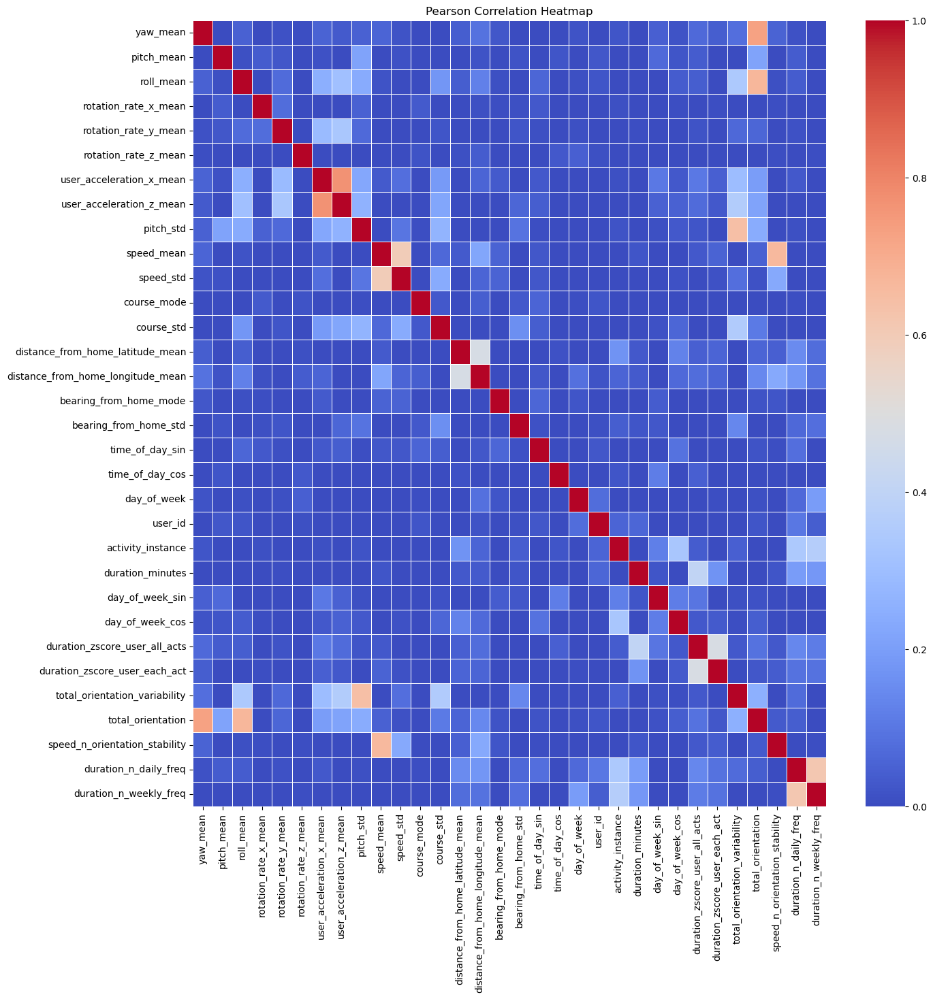


8 pairs with moderate linear correlation (0.6 to 0.8)


In [460]:
df_num = df3.select_dtypes(include='number').copy()
# Calculate the Pearson Correlation Matrix
corr_matrix_pear = df_num.corr(method='pearson')

# Plot the heatmap of the correlation matrix for the entire dataset
plt.figure(figsize=(15,15))
sns.heatmap(corr_matrix_pear, annot=False, cmap='coolwarm', vmin=0, center=0.5, vmax=1, linewidths=0.5, fmt='.2f')
plt.title('Pearson Correlation Heatmap')
plt.show()

# Collect high-correlation pairs
high_corr_pairs = []
mid_corr_pairs = []

for i in range(len(corr_matrix_pear.columns)):
    for j in range(i+1, len(corr_matrix_pear.columns)):
        col1 = corr_matrix_pear.columns[i]
        col2 = corr_matrix_pear.columns[j]
        corr_value = corr_matrix_pear.iloc[i, j]
        if abs(corr_value) >= 0.8:
            high_corr_pairs.append((col1, col2, corr_value))
        elif 0.6 < abs(corr_value) < 0.8:
            mid_corr_pairs.append((col1, col2, corr_value))

# Sort by absolute correlation in descending order
high_corr_pairs.sort(key=lambda x: abs(x[2]), reverse=True)

# Print
for col1, col2, corr_value in high_corr_pairs:
    print(f"{col1} - {col2}: {corr_value:.2f}")

print(f"\n{len(mid_corr_pairs)} pairs with moderate linear correlation (0.6 to 0.8)")

### Categorical

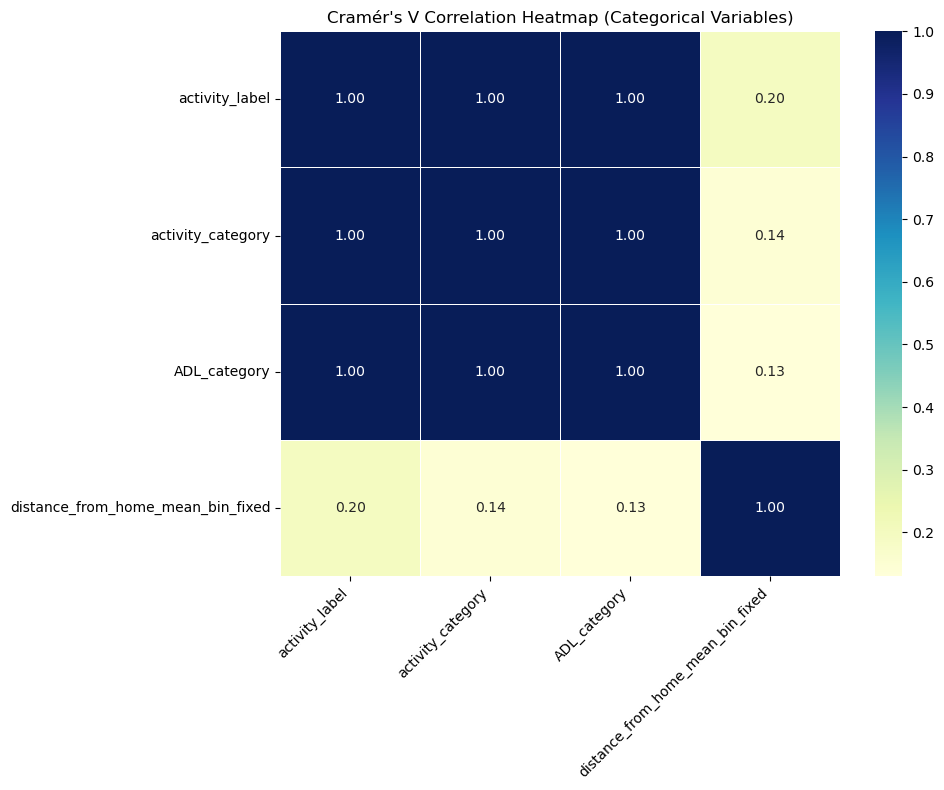

In [461]:
from scipy.stats import chi2_contingency

def cramers_v(x, y):
    confusion_matrix = pd.crosstab(x, y)
    chi2 = chi2_contingency(confusion_matrix)[0]
    n = confusion_matrix.sum().sum()
    phi2 = chi2 / n
    r, k = confusion_matrix.shape
    return np.sqrt(phi2 / min(k - 1, r - 1))

nonNum_cols = df2.select_dtypes(include=['object','category','bool']).columns.tolist()
# print(nonNum_cols)

# Create an empty DataFrame to hold Cramér's V values
cramers_results = pd.DataFrame(index=nonNum_cols, columns=nonNum_cols)

# Fill in the matrix
for col1 in nonNum_cols:
    for col2 in nonNum_cols:
        if col1 == col2:
            cramers_results.loc[col1, col2] = 1.0  # Perfect correlation with self
        else:
            value = cramers_v(df2[col1], df2[col2])
            cramers_results.loc[col1, col2] = value

# Convert all to float (some may be object type)
cramers_results = cramers_results.astype(float)

# Plot the heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(cramers_results, annot=True, cmap="YlGnBu", fmt=".2f", linewidths=0.5)
plt.title("Cramér's V Correlation Heatmap (Categorical Variables)")
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()



Observations:
* low correlation between distance_from_home_mean_bin_fixed and the activity labels/categories
* correlation between the labels & categories, as expected, as all of them directly relate to one another & are formed from one another only.
    * the categories are more informational
    * since we are predicting activities, we can drop the categories later.

## Clean up unwanted columns

In [462]:
# # keywords of columns to keep
# eng_cols = ['mean', 'std', 'activity', 'id', 'health', 'age']

# # Filter columns that contain any of the keywords
# columns_to_keep = [col for col in df3.columns if any(k in col.lower() for k in eng_cols)]

# # Create a new filtered DataFrame
# df3 = df3[columns_to_keep]
# print(df3.info())

# drop
cols_to_drop = ['user_id','activity_category','ADL_category']
df3 = df3.drop(columns=cols_to_drop)
print(df3.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 117795 entries, 0 to 117794
Data columns (total 33 columns):
 #   Column                             Non-Null Count   Dtype   
---  ------                             --------------   -----   
 0   yaw_mean                           117795 non-null  float64 
 1   pitch_mean                         117795 non-null  float64 
 2   roll_mean                          117795 non-null  float64 
 3   rotation_rate_x_mean               117795 non-null  float64 
 4   rotation_rate_y_mean               117795 non-null  float64 
 5   rotation_rate_z_mean               117795 non-null  float64 
 6   user_acceleration_x_mean           117795 non-null  float64 
 7   user_acceleration_z_mean           117795 non-null  float64 
 8   pitch_std                          117795 non-null  float64 
 9   speed_mean                         117795 non-null  float64 
 10  speed_std                          117795 non-null  float64 
 11  course_mode               

## Saving ADL falls dataset

In [463]:
# Save renamed ADL falls dataset
# df2.to_csv("ADLfalls_renamed.csv", index=False)
df3.to_csv("ADL_labelling_c17.csv", index=False)
